In [1]:
!git clone https://github.com/michalfaber/keras_Realtime_Multi-Person_Pose_Estimation.git

fatal: destination path 'keras_Realtime_Multi-Person_Pose_Estimation' already exists and is not an empty directory.


In [2]:
import os
from google.colab.patches import cv2_imshow
os.chdir('/content/keras_Realtime_Multi-Person_Pose_Estimation')
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
pip install configobj

In [4]:
import argparse
import time
import cv2
from processing import extract_parts, draw
from config_reader import config_reader
from model.cmu_model import get_testing_model
import pandas as pd 
import math
import numpy as np

In [5]:
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense

In [6]:
def define_model(length):
	# channel 1
	inputs = Input(shape=(length,))                                                                          
	dense1 = Dense(10, activation='relu')(inputs)
	dense2 = Dense(8, activation='relu')(dense1)
	outputs = Dense(6, activation='softmax')(dense2)
	model2 = Model(inputs=inputs, outputs=outputs)
	# compile
	model2.compile(loss='categorical_crossentropy', optimizer='adadelta', metrics=['accuracy'])
  
	# summarize
	print(model2.summary())
	return model2

In [7]:
import tensorflow as tf

model2 = define_model(12)

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 12)]              0         
_________________________________________________________________
dense (Dense)                (None, 10)                130       
_________________________________________________________________
dense_1 (Dense)              (None, 8)                 88        
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 54        
Total params: 272
Trainable params: 272
Non-trainable params: 0
_________________________________________________________________
None


In [8]:
from keras.models import load_model
model2 = load_model('/content/drive/MyDrive/model_100.h5')

In [9]:
keras_weights_file = '/content/drive/MyDrive/keras_multi_pose/model.h5'
model = get_testing_model()
model.load_weights(keras_weights_file)
params, model_params = config_reader()

In [10]:
# 1 padam
# 2 shav
# 3 Tadasana
# 4 Trik
# 5 Vriksh
# 6 Bhu

In [11]:
def extraction(input_image, params, model, model_params):
     tic = time.time()
     print('start processing...')
     body_parts, all_peaks, subset, candidate = extract_parts(input_image, params, model, model_params)
     canvas = draw(input_image, all_peaks, subset, candidate)
     toc = time.time()
     print('processing time is %.5f' % (toc - tic))
     #print(all_peaks)
     cv2_imshow(canvas)
     cv2.destroyAllWindows()
     return body_parts, all_peaks, subset, candidate

def points_extract(all_peaks):
 points = []
 for peak in all_peaks:
        try:
          m=peak[0][2:3]
          w_i=0
          for i in range(len(peak)):
             if(peak[i][2:3]>m):
                m=peak[i][2:3]
                w_i=i
          if(peak[w_i][2]>0.3):
             points.append((peak[w_i][:2]))
          else:
             points.append(("NA", "NA"))   
        except IndexError:
            points.append(("NA", "NA"))
 return points          


In [12]:
def extract_diff(all_peaks,n):
          points=points_extract(all_peaks)
          print(points)
          points_list=[]
          for i in range(18):
               points_list.append(points[i][0])
               points_list.append(points[i][1])
          d=pd.read_csv("/content/sample_data/sample.csv")      
          d.loc[0] = points_list
          df=d
          #print(d)
          d = d.replace(['NA'],0)
          d=d.iloc[:,2:28]
          pairs_arr=[[0,2],[2,4],[4,6],[0,8],[8,10],[10,12],[0,14],[14,16],[16,18],[0,20],[20,22],[22,24]]
          pairs_arr_cn=["[0,2]","[0,2]","[2,4]","[2,4]","[4,6]","[4,6]","[0,8]","[0,8]","[8,10]","[8,10]","[10,12]","[10,12]","[0,14]","[0,14]","[14,16]","[14,16]","[16,18]","[16,18]","[0,20]","[0,20]","[20,22]","[20,22]","[22,24]","[22,24]"]
          pairs_arr_cng=["[0,2]","[2,4]","[4,6]","[0,8]","[8,10]","[10,12]","[0,14]","[14,16]","[16,18]","[0,20]","[20,22]","[22,24]"]
          df_pv=pd.DataFrame(0, index=np.arange(1), columns=pairs_arr_cn)
          for i in range(len(pairs_arr)):
              a=pairs_arr[i][0]
              b=pairs_arr[i][1]
              df_pv.loc[0][i*2]=d.loc[0][b]-d.loc[0][a]
              df_pv.loc[0][i*2+1]=-1*(d.loc[0][b+1]-d.loc[0][a+1])
          df_gv=pd.DataFrame(0, index=np.arange(1), columns=pairs_arr_cng)    
          for i in range(len(pairs_arr)):
                    if (df_pv.loc[0][i*2]!=0 or df_pv.loc[0][i*2+1]!=0):
                          val=(df_pv.loc[0][i*2])/(((df_pv.loc[0][i*2]**2)+(df_pv.loc[0][i*2+1]**2))**(0.5))
                          if ( (df_pv.loc[0][i*2+1]>0)):
                              df_gv.loc[0][i]=math.acos(val)*180*(1/3.141592653589793)
                          else:
                              df_gv.loc[0][i]=360 - math.acos(val)*180*(1/3.141592653589793)
                    else:
                          df_gv.loc[0][i]=1000
          inputs= df_gv.to_numpy()  
          set_pose=n
          if (set_pose==1):
             if (inputs[0][9]<=10):
                 inputs[0][9]=inputs[0][9]+360
          if (set_pose==2):
             if (inputs[0][3]<=10):
                 inputs[0][3]=inputs[0][3]+360
             if (inputs[0][2]>=330):
                inputs[0][2]=360-inputs[0][2]    
          if (set_pose==3):
             if (inputs[0][3]>=330):
                inputs[0][3]=360-inputs[0][3]
          if (set_pose==4):
                inputs[0][0]=1000
                inputs[0][1]=1000
                inputs[0][2]=1000
          if (set_pose==5):
                inputs[0][0]=1000
                inputs[0][3]=1000
                inputs[0][4]=1000
                inputs[0][5]=1000
          if (set_pose==6):
             if (inputs[0][8]<=50):
                inputs[0][8]=inputs[0][8]+360  
             if (inputs[0][10]<=50):
                inputs[0][10]=inputs[0][10]+360     
          y=model2.predict(inputs)
          arr=[]
          for h in range(6):
               if (y[0][h]>0.5):
                 arr.append(1)
               else:
                 arr.append(0)  
          print(arr) 
          ind=0
          for i in range(6):
              if (arr[i]==1):
                  ind=i 
          diff_arr=[]     
          for i in range(12):
              diff=inputs[0][i]-arr_avg[ind][i]
              diff_arr.append(diff)  
          print(diff_arr)  
          return inputs,arr,diff_arr   

In [13]:
ins_arr=["rotate joint neck to right shoulder       ","rotate joint right shoulder to right elbow","rotate joint right elbow to right wrist   ","rotate joint neck to left shoulder        ","rotate joint left shoulder to left elbow  ","rotate joint left elbow to left wrist     ",
         "rotate joint neck to right hip            ","rotate joint right hip to right knee      ","rotate joint right knee to right ankle    ","rotate joint neck to left hip             ","rotate joint left hip to left knee        ","rotate joint left knee to left ankle      "]
ins_dir=["clock-wise by degrees     ","anti-clock-wise by degress"]         

In [14]:
ins_arr

['rotate joint neck to right shoulder       ',
 'rotate joint right shoulder to right elbow',
 'rotate joint right elbow to right wrist   ',
 'rotate joint neck to left shoulder        ',
 'rotate joint left shoulder to left elbow  ',
 'rotate joint left elbow to left wrist     ',
 'rotate joint neck to right hip            ',
 'rotate joint right hip to right knee      ',
 'rotate joint right knee to right ankle    ',
 'rotate joint neck to left hip             ',
 'rotate joint left hip to left knee        ',
 'rotate joint left knee to left ankle      ']

In [15]:
arr_avg=[[179.22,
  251.58,
  243.16,
  359.5,
  288.26,
  297.3,
  255.56,
  200.92,
  362.46,
  283.26,
  339.98,
  177.02],
 [1000.0,
  1000.0,
  1000.0,
  285.94,
  190.98,
  189.24,
  181.44,
  177.48,
  184.24,
  181.44,
  177.64,
  184.18],
 [180.63333333333333,
  93.96666666666667,
  78.43333333333334,
  2.7,
  84.25,
  95.86666666666666,
  258.1,
  269.3666666666667,
  269.9,
  279.23333333333335,
  266.1,
  266.1666666666667],
 [253.8923076923077,
  266.53846153846155,
  257.03076923076924,
  80.84615384615384,
  77.67692307692307,
  87.96923076923076,
  319.81538461538463,
  241.53846153846155,
  245.0,
  343.81538461538463,
  290.18461538461537,
  286.26153846153846],
 [177.1818181818182,
  245.21818181818182,
  20.236363636363638,
  357.6909090909091,
  290.25454545454545,
  155.56363636363636,
  249.0,
  218.6727272727273,
  327.1454545454545,
  274.4909090909091,
  258.90909090909093,
  258.6545454545454],
 [1000.0,
  270.75714285714287,
  276.15714285714284,
  1000.0,
  1000.0,
  1000.0,
  233.12857142857143,
  187.8,
  175.78571428571428,
  233.12857142857143,
  187.8,
  175.78571428571428]]

In [16]:
cap = cv2.VideoCapture('/content/drive/MyDrive/yoga vid collector/Piyush_Trikon.mp4')
frameRate = 60
m=6
n=7
frame_inputs=[]
frame_labels=[]
frame_diff=[]

0.0        0.0


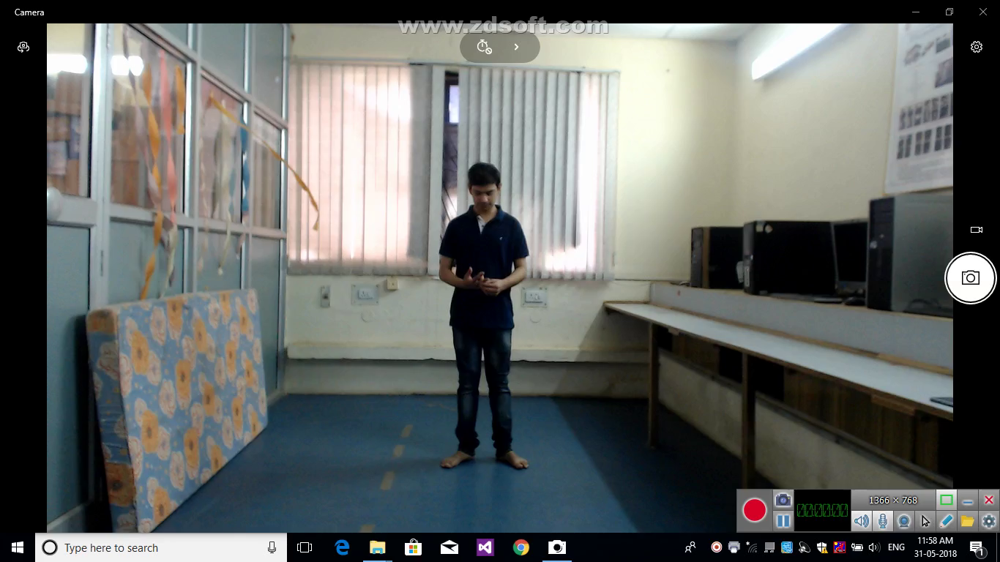

60.0        1.0


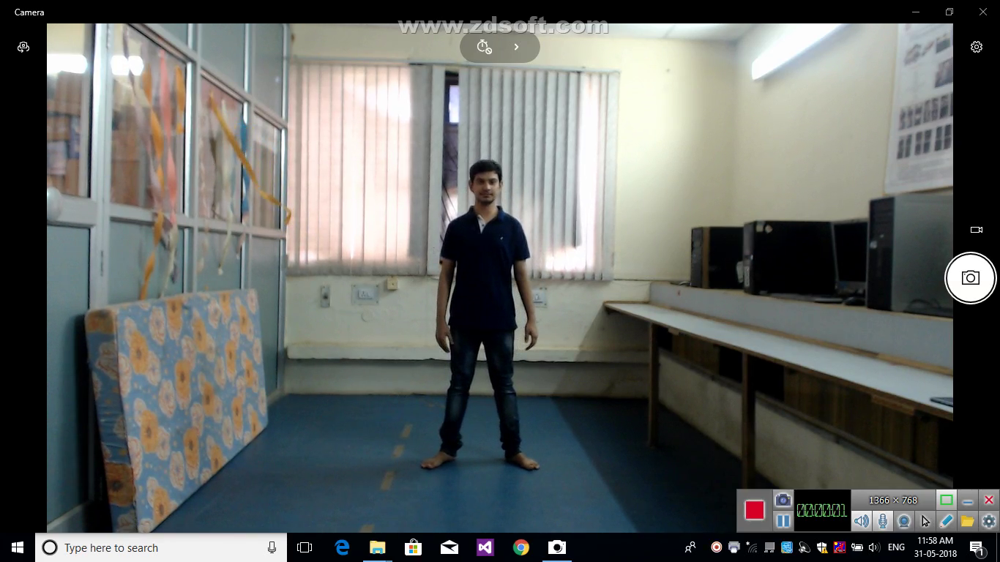

120.0        2.0


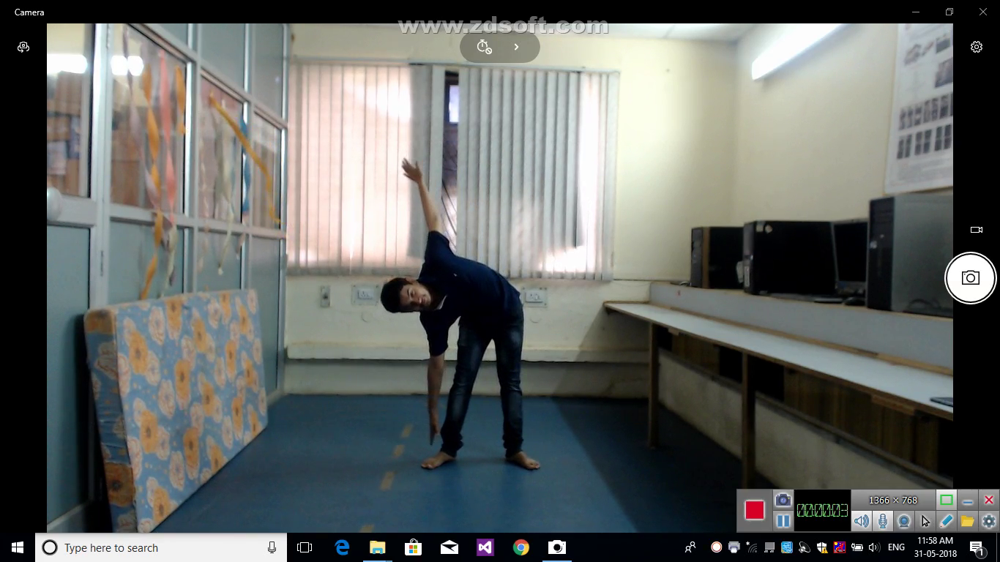

180.0        3.0


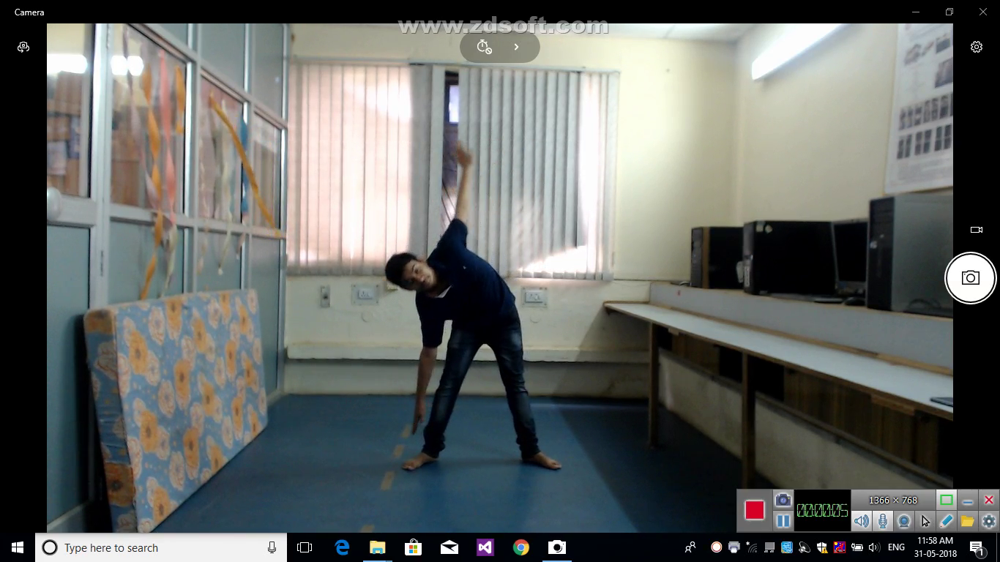

240.0        4.0


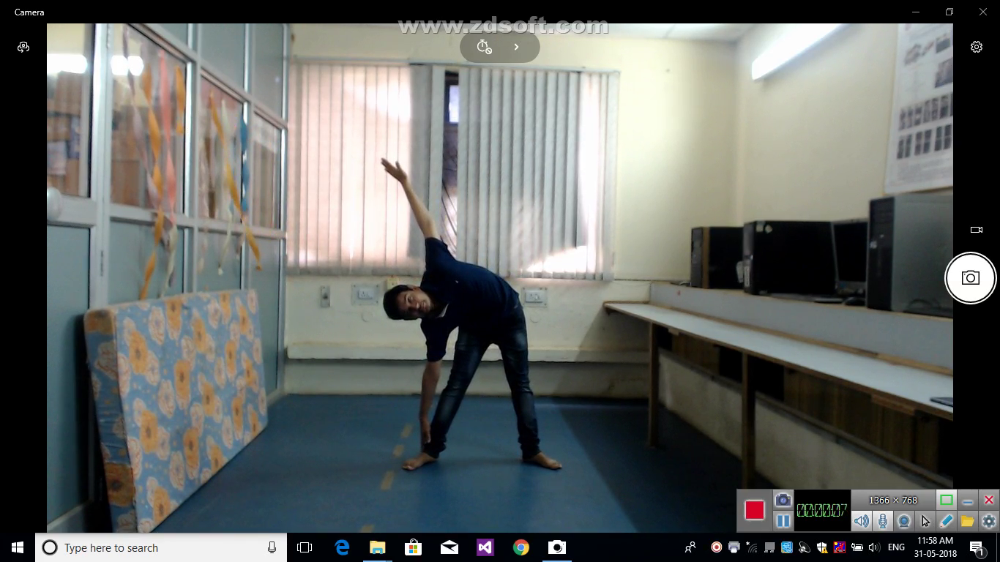

300.0        5.0


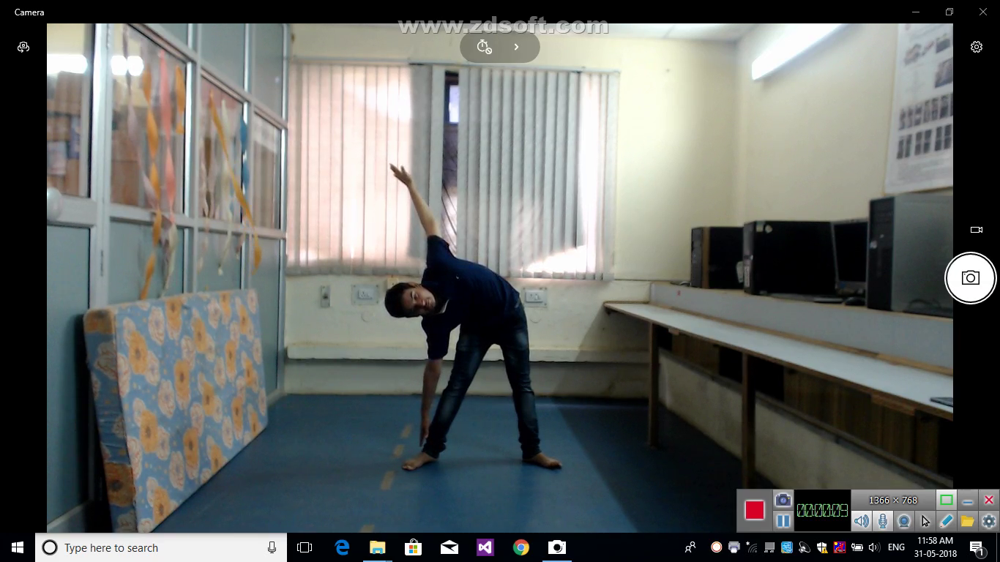

360.0        6.0


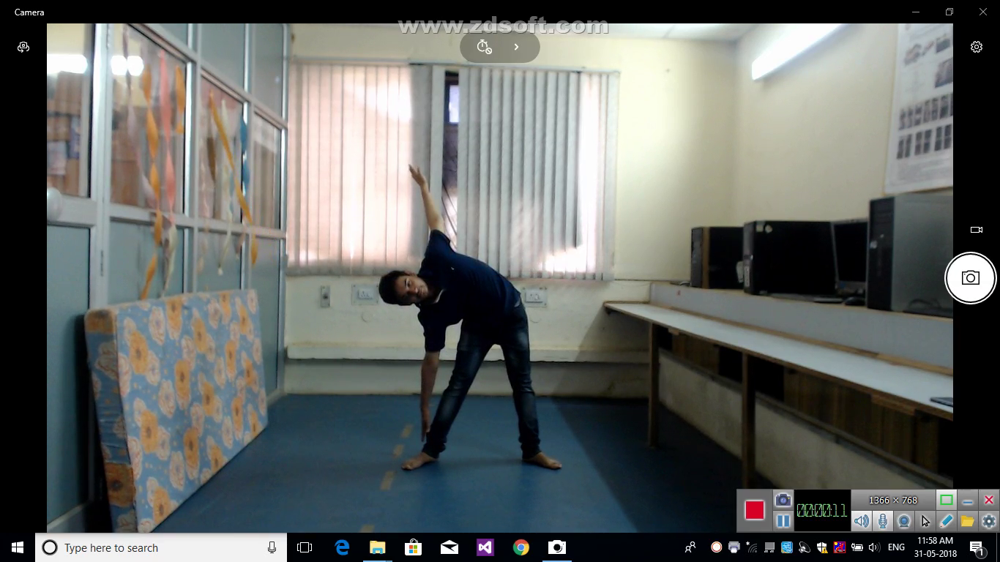

start processing...
processing time is 66.07784


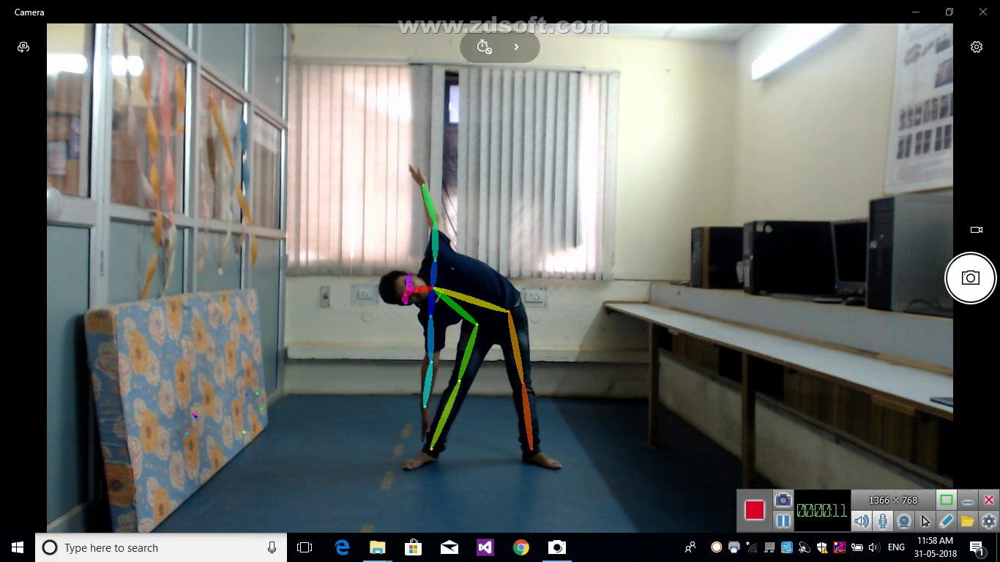

[(563, 397), (591, 393), (588, 431), (589, 494), (580, 555), (594, 356), (594, 303), (578, 253), (651, 443), (627, 520), (589, 613), (694, 425), (714, 523), (726, 613), (553, 402), (557, 388), (554, 414), (559, 375)]
[0, 0, 0, 1, 0, 0]
[11.107692307692304, 3.461538461538453, 3.9692307692307622, 4.15384615384616, 12.323076923076925, 19.030769230769238, 0.18461538461536975, 10.461538461538453, 2.0, -1.8153846153846303, -9.18461538461537, -9.261538461538464]
rotate joint neck to right shoulder          clock-wise by degrees          11.107692307692304
rotate joint right shoulder to right elbow   clock-wise by degrees          3.461538461538453
rotate joint right elbow to right wrist      clock-wise by degrees          3.9692307692307622
rotate joint neck to left shoulder           clock-wise by degrees          4.15384615384616
rotate joint left shoulder to left elbow     clock-wise by degrees          12.323076923076925
rotate joint left elbow to left wrist        clock-wise by degrees  

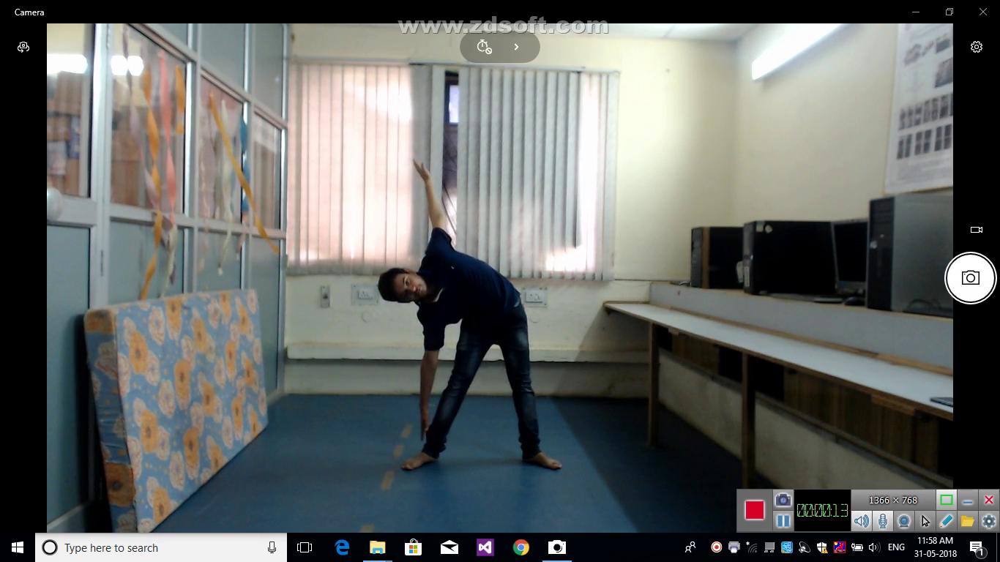

start processing...
processing time is 63.78754


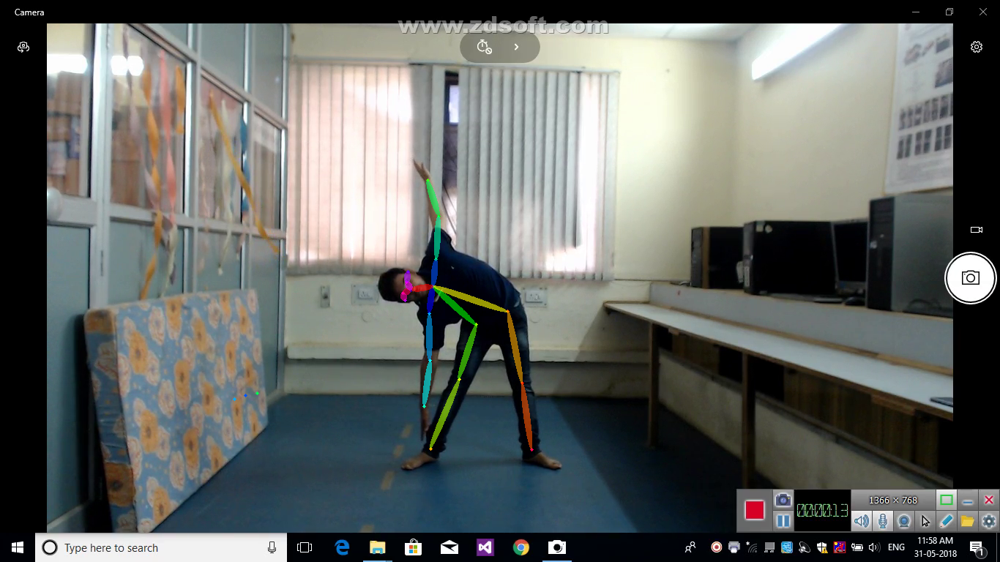

[(561, 396), (591, 391), (586, 428), (587, 492), (579, 555), (595, 354), (599, 295), (584, 246), (650, 443), (627, 518), (588, 613), (693, 425), (713, 523), (726, 614), (550, 400), (555, 385), ('NA', 'NA'), (557, 371)]
[0, 0, 0, 1, 0, 0]
[8.107692307692304, 3.461538461538453, 4.969230769230762, 2.1538461538461604, 8.323076923076925, 19.030769230769238, -1.8153846153846303, 10.461538461538453, 2.0, -2.8153846153846303, -9.18461538461537, -8.261538461538464]
rotate joint neck to right shoulder          clock-wise by degrees          8.107692307692304
rotate joint right shoulder to right elbow   clock-wise by degrees          3.461538461538453
rotate joint right elbow to right wrist      clock-wise by degrees          4.969230769230762
rotate joint neck to left shoulder           clock-wise by degrees          2.1538461538461604
rotate joint left shoulder to left elbow     clock-wise by degrees          8.323076923076925
rotate joint left elbow to left wrist        clock-wise by degrees  

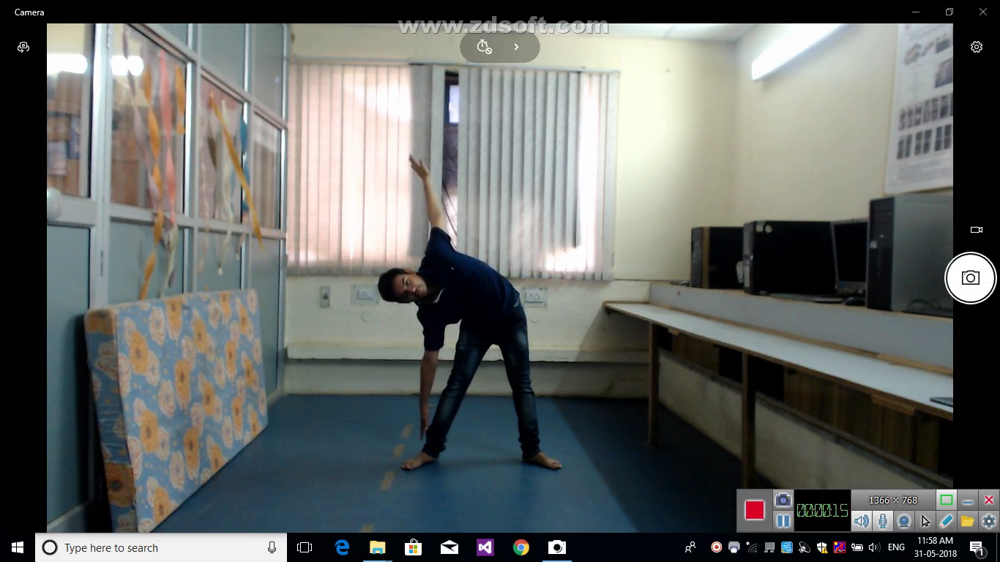

540.0        9.0


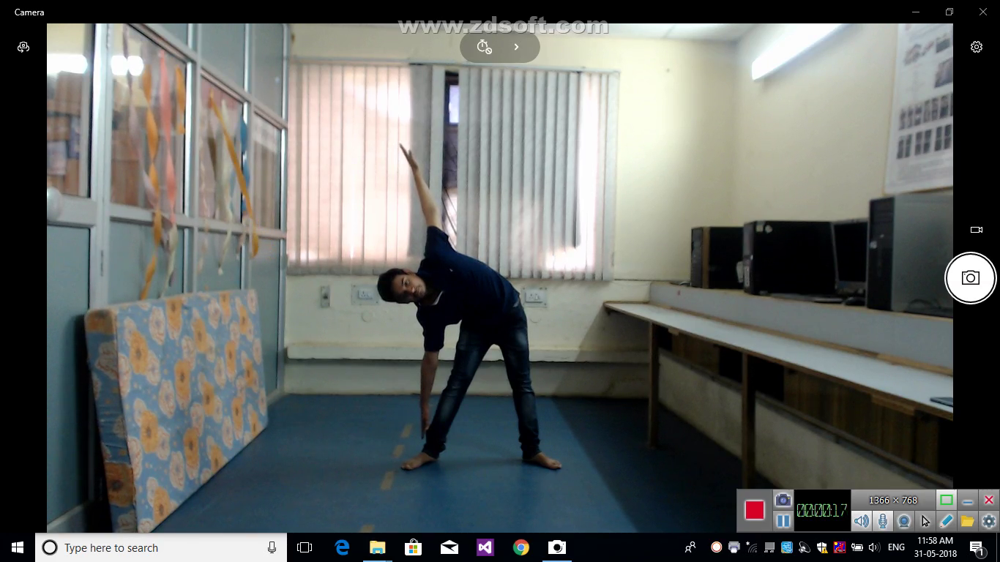

600.0        10.0


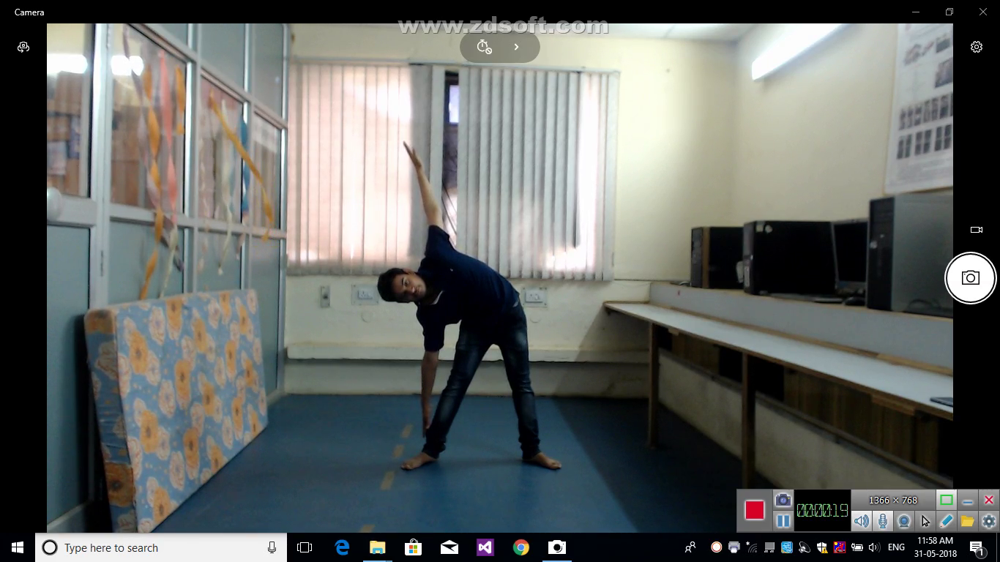

660.0        11.0


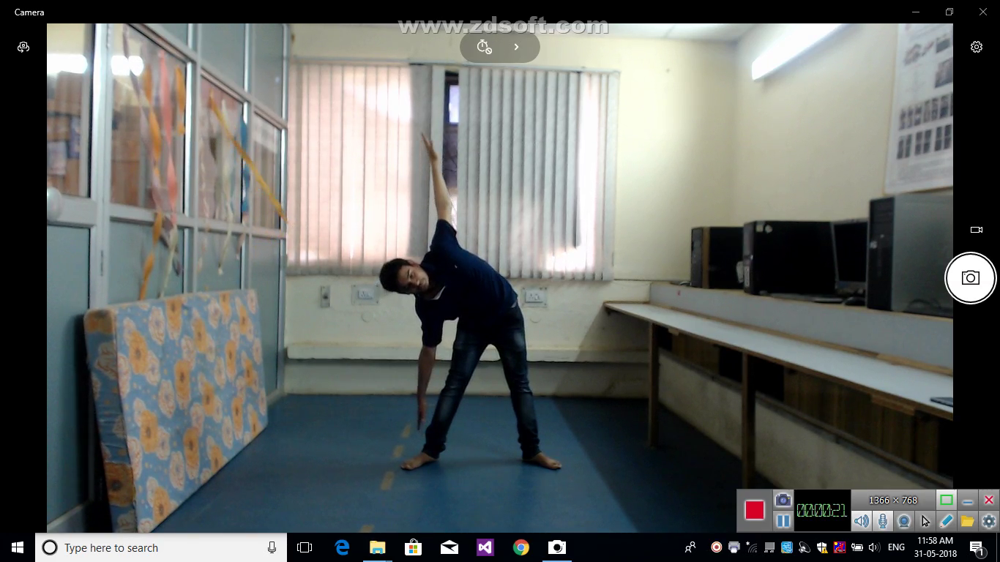

720.0        12.0


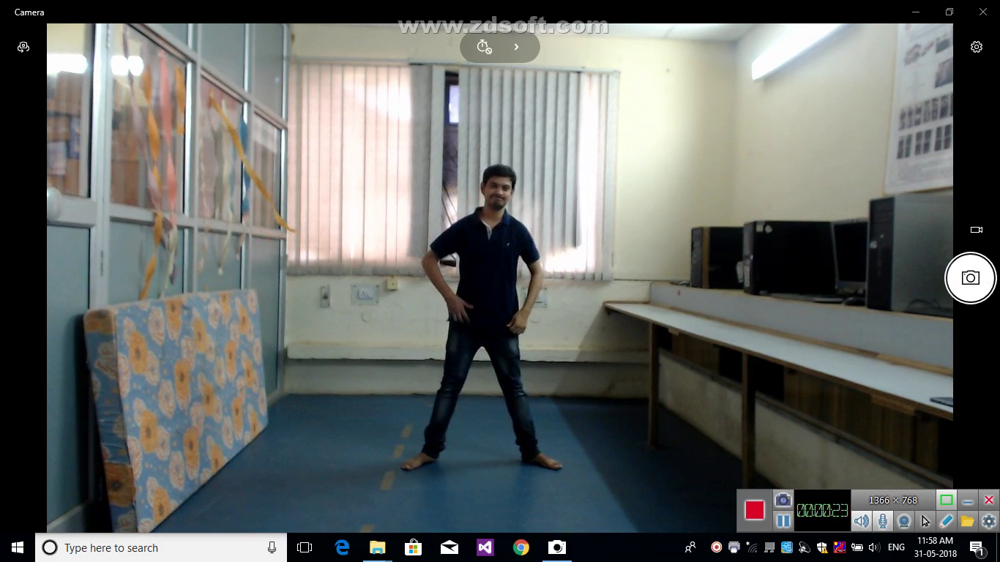

780.0        13.0


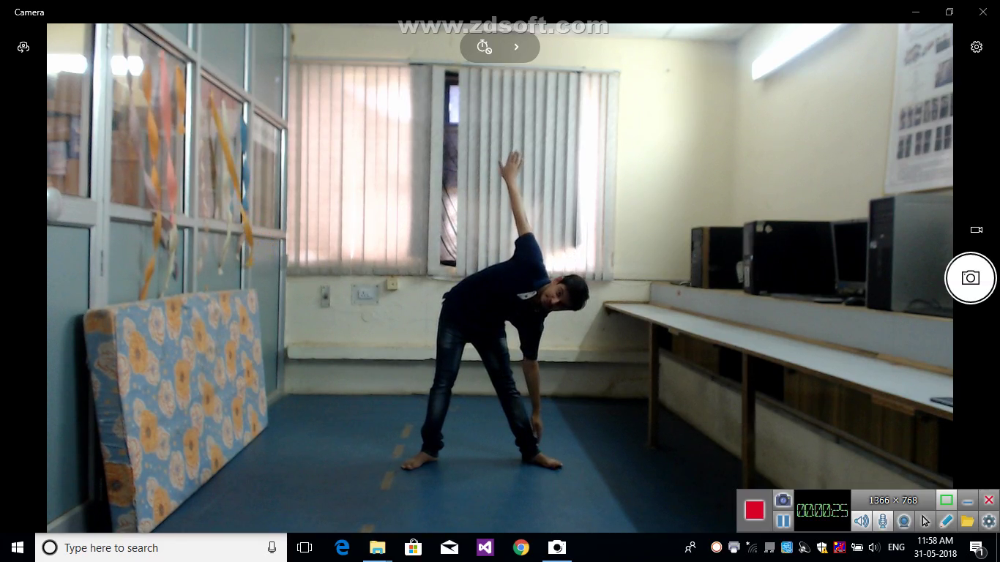

840.0        14.0


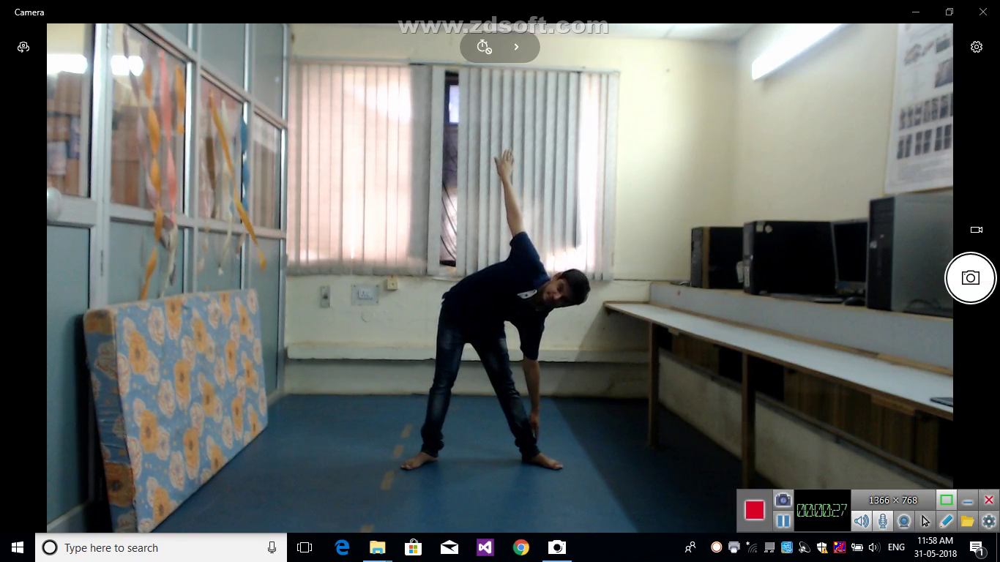

900.0        15.0


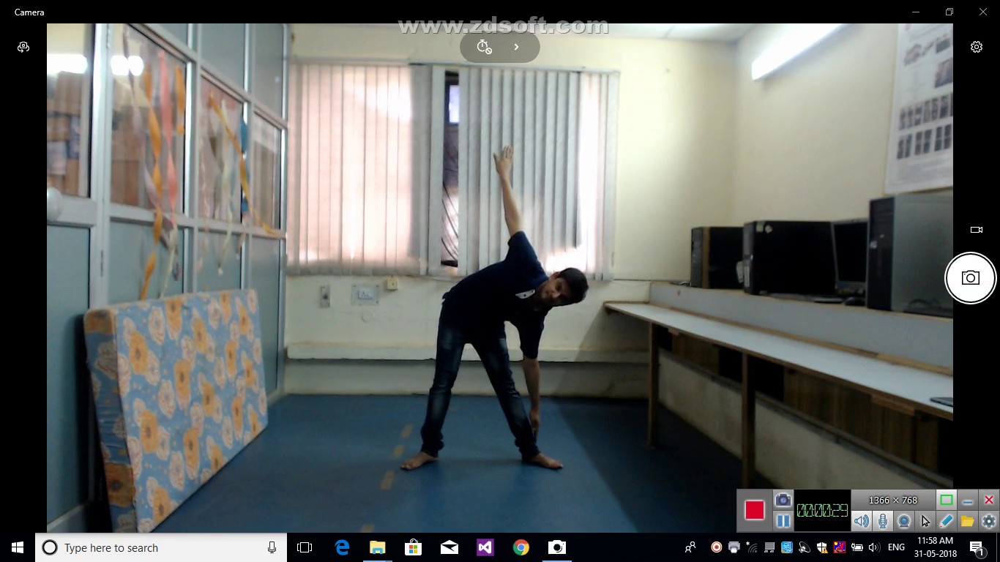

960.0        16.0


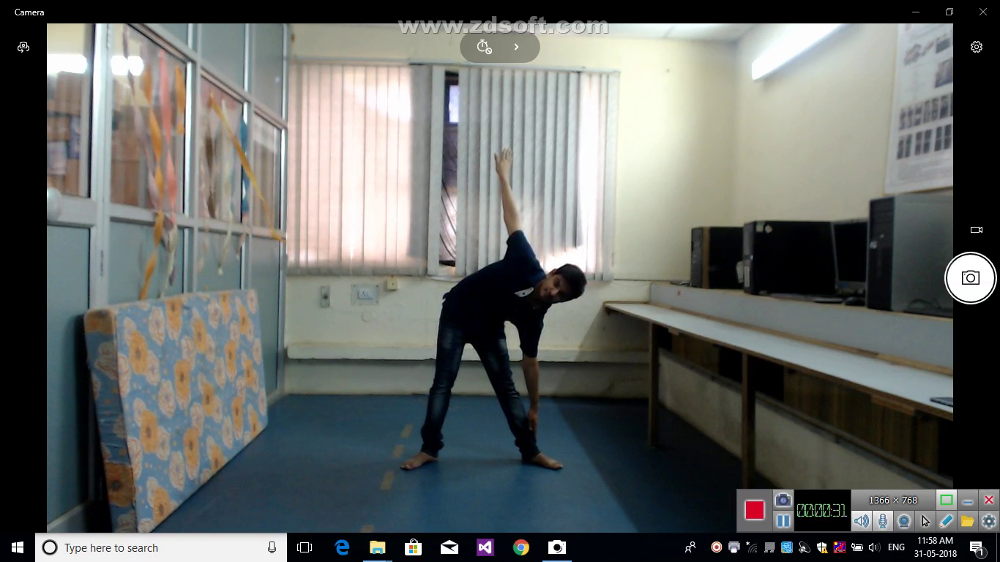

1020.0        17.0


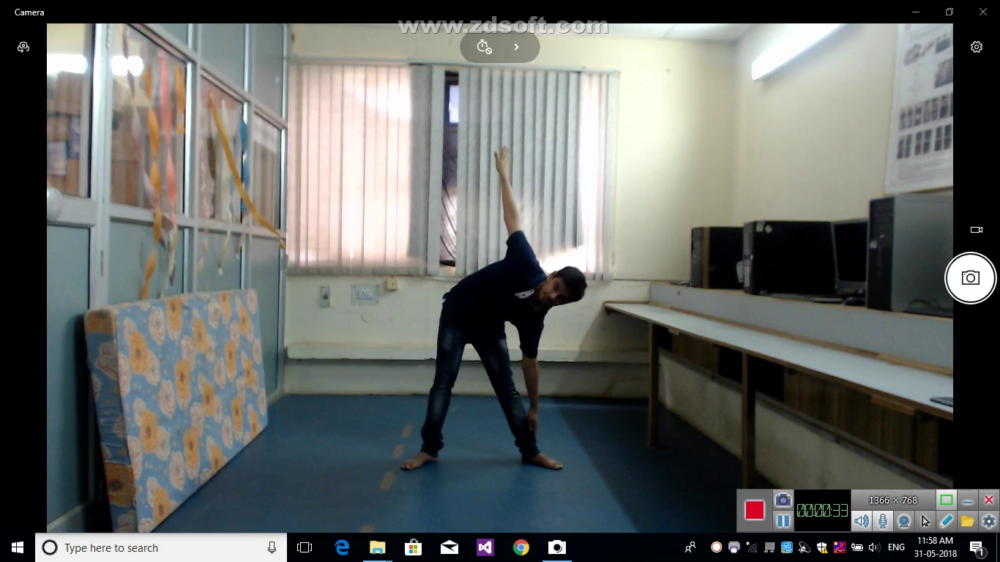

1080.0        18.0


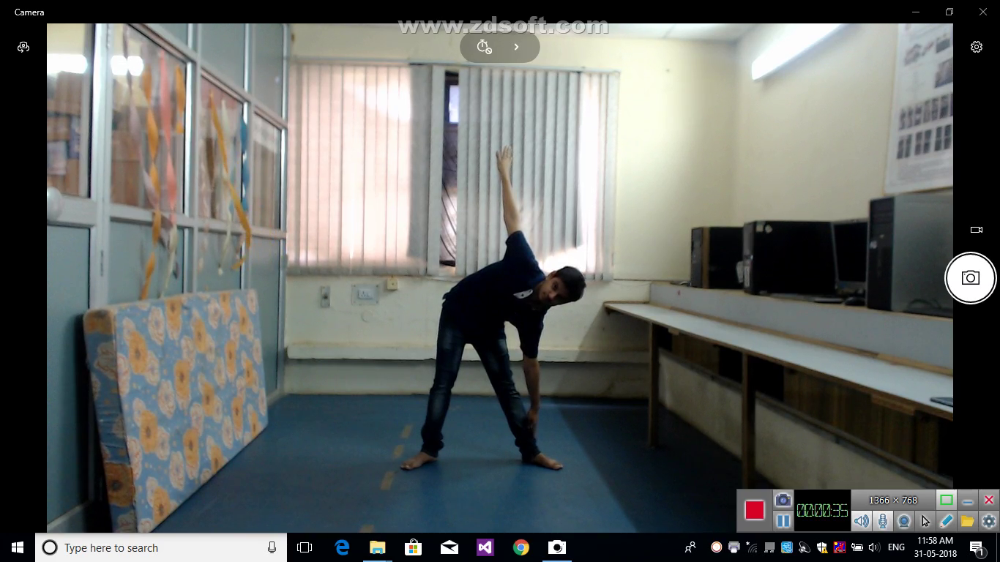

1140.0        19.0


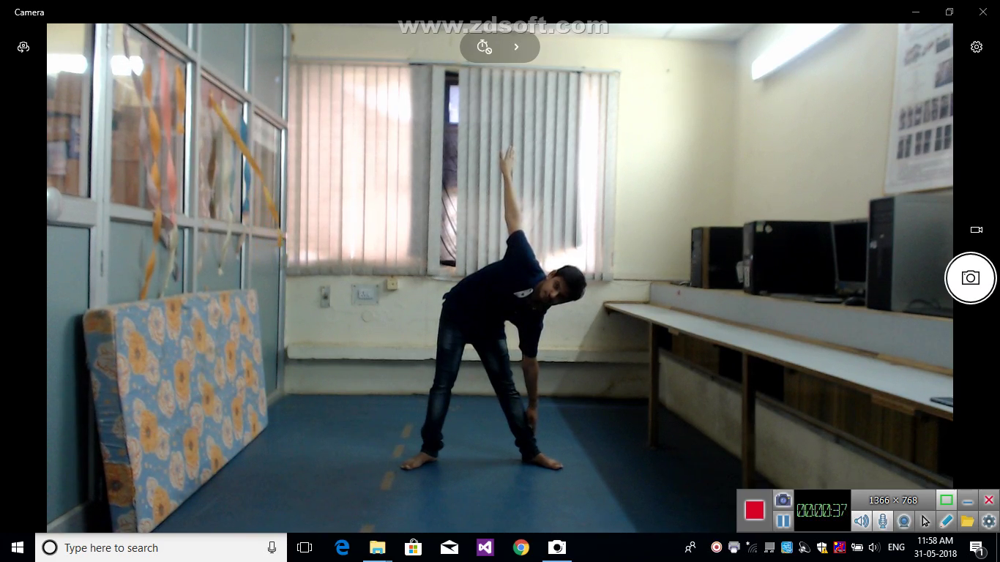

1200.0        20.0


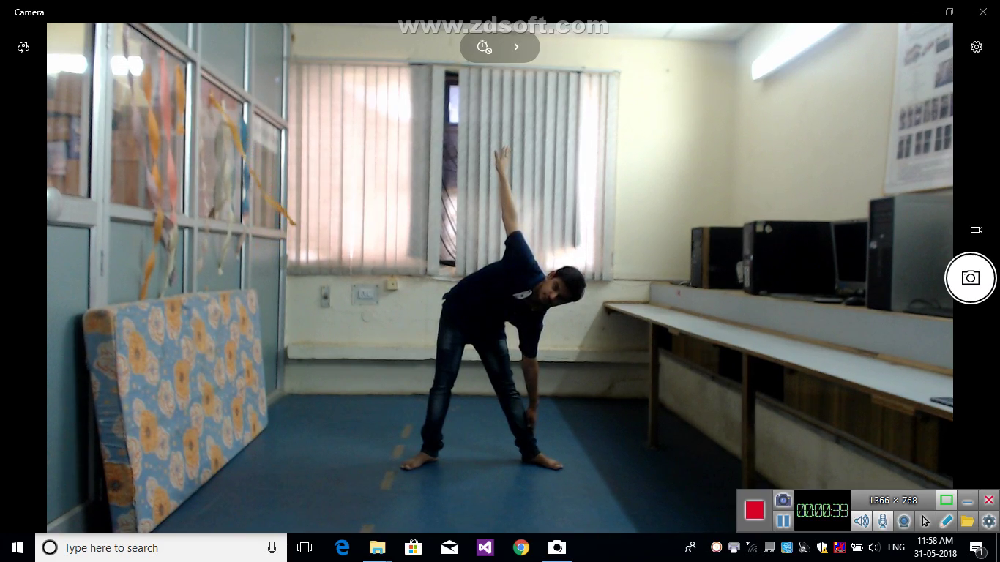

Done!


In [17]:
while(cap.isOpened()):
  frameId = cap.get(1)
  ret, frame = cap.read()
  if (ret != True):  
        break      
  if (frameId % frameRate == 0):
      print(frameId,"      ",frameId/frameRate)
      cv2_imshow(frame)
      if (m<=frameId/frameRate<=n):
          body_parts, all_peaks, subset, candidate=extraction(frame, params, model, model_params)
          inputs,labels,diff_arr=extract_diff(all_peaks,1)
          frame_labels.append(labels)
          frame_diff.append(diff_arr)
          frame_inputs.append(inputs)
          for i in range(12):
              if (diff_arr[i]>0):
                   print(ins_arr[i]," ",ins_dir[0],"   ",diff_arr[i])
              else:    
                   print(ins_arr[i]," ",ins_dir[1],"   ",-1*diff_arr[i])
  #Frame=frame    
cap.release()
print ("Done!")      

In [18]:
frame_labels

[[0, 0, 0, 1, 0, 0], [0, 0, 0, 1, 0, 0]]

In [19]:
frame_diff

[[11.107692307692304,
  3.461538461538453,
  3.9692307692307622,
  4.15384615384616,
  12.323076923076925,
  19.030769230769238,
  0.18461538461536975,
  10.461538461538453,
  2.0,
  -1.8153846153846303,
  -9.18461538461537,
  -9.261538461538464],
 [8.107692307692304,
  3.461538461538453,
  4.969230769230762,
  2.1538461538461604,
  8.323076923076925,
  19.030769230769238,
  -1.8153846153846303,
  10.461538461538453,
  2.0,
  -2.8153846153846303,
  -9.18461538461537,
  -8.261538461538464]]

In [20]:
frame_inputs

[array([[265, 270, 261,  85,  90, 107, 320, 252, 247, 342, 281, 277]]),
 array([[262, 270, 262,  83,  86, 107, 318, 252, 247, 341, 281, 278]])]

In [21]:
arr_avg[0]

[179.22,
 251.58,
 243.16,
 359.5,
 288.26,
 297.3,
 255.56,
 200.92,
 362.46,
 283.26,
 339.98,
 177.02]